In [1]:
#Mounting Google Drive to Colab
#This will open a link with a code : Copy paste that code in the output window
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np 
import cv2
from google.colab.patches import cv2_imshow

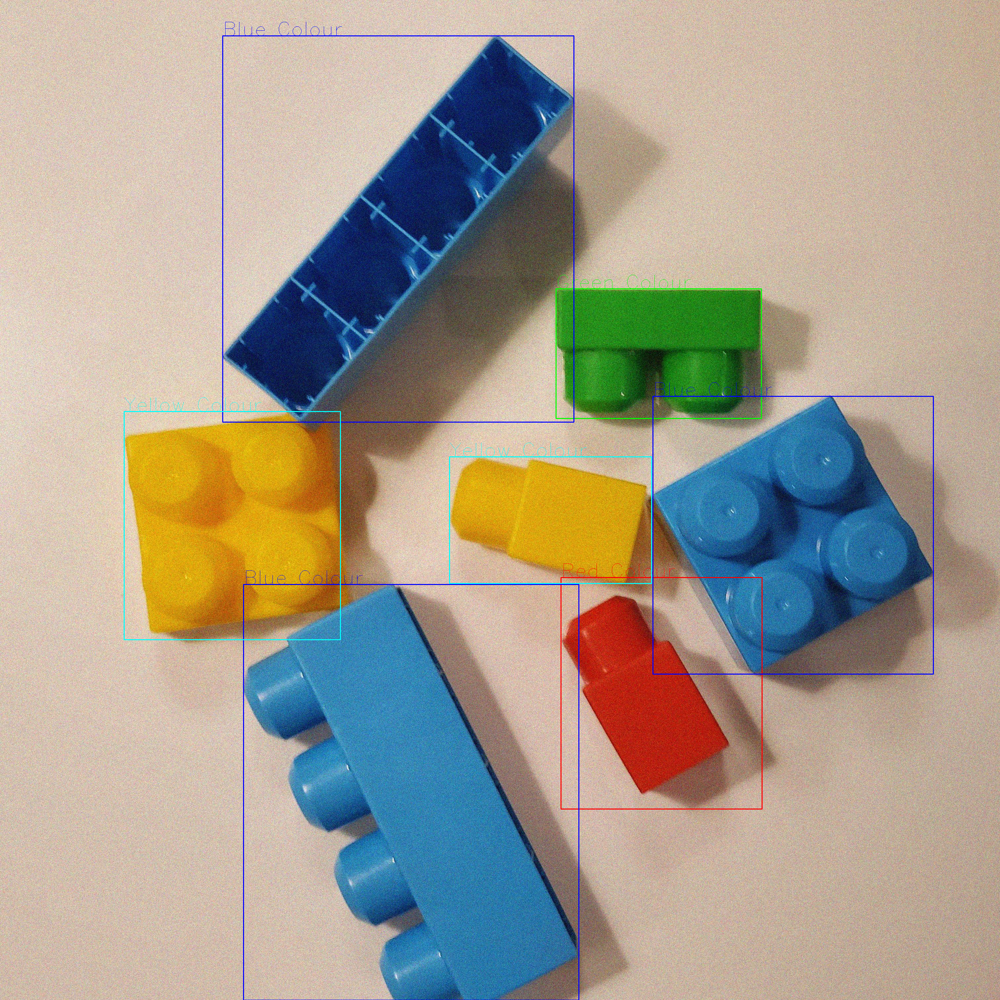

In [5]:
# Reading the image from google drive folder 
webcam = cv2.imread('/content/drive/My Drive/Check/augmented_image_4.jpg')
  
for num in range(0,1):
      
    # Assigning image to a different variable  
    imageFrame = webcam
  
    # Convert the imageFrame in  
    # BGR to HSV Conversion
    hsvFrame = cv2.cvtColor(imageFrame, cv2.COLOR_BGR2HSV) 
  
    # Set range for red color and  
    # define mask 
    red_lower = np.array([0, 100, 100], np.uint8) 
    red_upper = np.array([10, 255, 255], np.uint8) 
    red_mask = cv2.inRange(hsvFrame, red_lower, red_upper) 
  
    # Set range for green color and  
    # define mask 
    green_lower = np.array([50, 52, 72], np.uint8) 
    green_upper = np.array([70, 255, 255], np.uint8) 
    green_mask = cv2.inRange(hsvFrame, green_lower, green_upper) 
  
    # Set range for blue color and 
    # define mask 
    blue_lower = np.array([94, 80, 2], np.uint8) 
    blue_upper = np.array([120, 255, 255], np.uint8) 
    blue_mask = cv2.inRange(hsvFrame, blue_lower, blue_upper)

    # Set range for yellow color and 
    # define mask 
    yellow_lower = np.array([20, 100, 100], np.uint8) 
    yellow_upper = np.array([30, 255, 255], np.uint8) 
    yellow_mask = cv2.inRange(hsvFrame, yellow_lower, yellow_upper) 
      
    # Morphological Transform, Dilation 
    # for each color and bitwise_and operator 
    # between imageFrame and mask determines 
    # to detect only that particular color 
    kernal = np.ones((5, 5), "uint8")

    # For red color 
    red_mask = cv2.dilate(red_mask, kernal) 
    res_red = cv2.bitwise_and(imageFrame, imageFrame,  
                              mask = red_mask) 
      
    # For green color 
    green_mask = cv2.dilate(green_mask, kernal) 
    res_green = cv2.bitwise_and(imageFrame, imageFrame, 
                                mask = green_mask) 
      
    # For blue color 
    blue_mask = cv2.dilate(blue_mask, kernal) 
    res_blue = cv2.bitwise_and(imageFrame, imageFrame, 
                               mask = blue_mask) 
    
    # For yellow color 
    yellow_mask = cv2.dilate(yellow_mask, kernal) 
    res_yellow = cv2.bitwise_and(imageFrame, imageFrame, 
                               mask = yellow_mask)
   
    # Creating contour to track red color 
    contours, hierarchy = cv2.findContours(red_mask, 
                                           cv2.RETR_TREE, 
                                           cv2.CHAIN_APPROX_SIMPLE)
    
    for pic, contour in enumerate(contours): 
        area = cv2.contourArea(contour) 
        if(area > 40000): 
            x, y, w, h = cv2.boundingRect(contour) 
            imageFrame = cv2.rectangle(imageFrame, (x, y),  
                                       (x + w, y + h),  
                                       (0, 0, 255), 2) 
              
            cv2.putText(imageFrame, "Red Colour", (x, y), 
                        cv2.FONT_HERSHEY_SIMPLEX, 2.0, 
                        (0, 0, 255))     
  
    # Creating contour to track green color 
    contours, hierarchy = cv2.findContours(green_mask, 
                                           cv2.RETR_TREE, 
                                           cv2.CHAIN_APPROX_SIMPLE) 
      
    for pic, contour in enumerate(contours): 
        area = cv2.contourArea(contour) 
        if(area > 40000): 
            x, y, w, h = cv2.boundingRect(contour) 
            imageFrame = cv2.rectangle(imageFrame, (x, y),  
                                       (x + w, y + h), 
                                       (0, 255, 0), 2) 
            cv2.putText(imageFrame, "Green Colour", (x, y), 
                        cv2.FONT_HERSHEY_SIMPLEX,  
                        2.0, (0, 255, 0)) 
  
    # Creating contour to track blue color 
    contours, hierarchy = cv2.findContours(blue_mask, 
                                           cv2.RETR_TREE, 
                                           cv2.CHAIN_APPROX_SIMPLE) 
    for pic, contour in enumerate(contours): 
        area = cv2.contourArea(contour) 
        if(area > 40000): 
            x, y, w, h = cv2.boundingRect(contour) 
            imageFrame = cv2.rectangle(imageFrame, (x, y), 
                                       (x + w, y + h), 
                                       (255, 0, 0), 2) 
              
            cv2.putText(imageFrame, "Blue Colour", (x, y), 
                        cv2.FONT_HERSHEY_SIMPLEX, 
                        2.0, (255, 0, 0))
            
     # Creating contour to track yellow color 
    contours, hierarchy = cv2.findContours(yellow_mask, 
                                           cv2.RETR_TREE, 
                                           cv2.CHAIN_APPROX_SIMPLE) 
    for pic, contour in enumerate(contours): 
        area = cv2.contourArea(contour) 
        if(area > 40000): 
            x, y, w, h = cv2.boundingRect(contour) 
            imageFrame = cv2.rectangle(imageFrame, (x, y), 
                                       (x + w, y + h), 
                                       (255, 255, 0), 2) 
              
            cv2.putText(imageFrame, "Yellow Colour", (x, y), 
                        cv2.FONT_HERSHEY_SIMPLEX, 
                        2.0, (255, 255, 0)) 
              
    # Program Termination 
    cv2_imshow(imageFrame) 
    if cv2.waitKey(10) & 0xFF == ord('q'): 
        cap.release() 
        cv2.destroyAllWindows() 
        break